In [ ]:
!wget 'http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/maps.tar.gz' -P '/content/drive/MyDrive/B19EE046_Q3/' 

--2022-04-29 12:32:51--  http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/maps.tar.gz
Resolving efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)... 128.32.244.190
Connecting to efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)|128.32.244.190|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 250242400 (239M) [application/x-gzip]
Saving to: ‘/content/drive/MyDrive/B19EE046_Q3/maps.tar.gz’

maps.tar.gz         100%[===================>] 238.65M  2.13MB/s    in 1m 59s  

2022-04-29 12:34:50 (2.01 MB/s) - ‘/content/drive/MyDrive/B19EE046_Q3/maps.tar.gz’ saved [250242400/250242400]



In [ ]:
!tar -xvf  '/content/drive/MyDrive/B19EE046_Q3/maps.tar.gz'  -C '/content/drive/MyDrive/B19EE046_Q3/dataset'

maps/
maps/train/
maps/train/1.jpg
maps/train/10.jpg
maps/train/100.jpg
maps/train/1000.jpg
maps/train/1001.jpg
maps/train/1002.jpg
maps/train/1003.jpg
maps/train/1004.jpg
maps/train/1005.jpg
maps/train/1006.jpg
maps/train/1007.jpg
maps/train/1008.jpg
maps/train/1009.jpg
maps/train/101.jpg
maps/train/1010.jpg
maps/train/1011.jpg
maps/train/1012.jpg
maps/train/1013.jpg
maps/train/1014.jpg
maps/train/1015.jpg
maps/train/530.jpg
maps/train/531.jpg
maps/train/532.jpg
maps/train/533.jpg
maps/train/534.jpg
maps/train/535.jpg
maps/train/536.jpg
maps/train/537.jpg
maps/train/538.jpg
maps/train/539.jpg
maps/train/54.jpg
maps/train/540.jpg
maps/train/541.jpg
maps/train/542.jpg
maps/train/543.jpg
maps/train/544.jpg
maps/train/545.jpg
maps/train/546.jpg
maps/train/547.jpg
maps/train/548.jpg
maps/train/549.jpg
maps/train/55.jpg
maps/train/550.jpg
maps/train/551.jpg
maps/train/552.jpg
maps/train/553.jpg
maps/train/554.jpg
maps/train/555.jpg
maps/train/556.jpg
maps/train/557.jpg
maps/train/558.jpg
ma

In [ ]:
import numpy as np
import os
import torch
from torchvision import datasets, transforms, models
from tqdm import tqdm
import matplotlib.pyplot as plt
import cv2
import pandas as pd
from torch.utils.data import Dataset
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [ ]:
def save_dataframe(directory):
  df = pd.DataFrame(columns=['Image_Name'])
  img_name_list=os.listdir(directory)
  df['Image_Name']=img_name_list
  save_directory = directory+'meta.csv'
  df.to_csv(save_directory)

In [ ]:
#save_dataframe('/content/drive/MyDrive/B19EE046_Q3/dataset/maps/train/')
image_df = pd.read_csv('/content/drive/MyDrive/B19EE046_Q3/dataset/maps/train/meta.csv')
image_df = image_df.drop(columns=['Unnamed: 0'])

In [ ]:
#save_dataframe('/content/drive/MyDrive/B19EE046_Q3/dataset/maps/val/')
image_df2 = pd.read_csv('/content/drive/MyDrive/B19EE046_Q3/dataset/maps/val/meta.csv')
image_df2 = image_df2.drop(columns=['Unnamed: 0'])

In [ ]:
class Data_Prepare(Dataset):
  """
  The Class will act as the container for our dataset. It will take your dataframe, the root path, and also the transform function for transforming the dataset.
  """
  def __init__(self, data_frame, root_dir, transform=None):
    self.data_frame = data_frame
    self.root_dir = root_dir
    self.transform = transform
  def __len__(self):
    # Return the length of the dataset
    return len(self.data_frame)
  def __getitem__(self, idx):
    # Return the observation based on an index. Ex. dataset[0] will return the first element from the dataset, in this case the image and the label.
    if torch.is_tensor(idx):
      idx = idx.tolist()    
    img_name = os.path.join(self.root_dir, self.data_frame.iloc[idx, 0])
    image = cv2.imread(img_name)
    input_image = image[:,:int(image.shape[1]/2),:]
    real_image = image[:,int(image.shape[1]/2):,:]
    real_label = float(1)
    input_label = float(0)
    if self.transform:
      input_image = self.transform(input_image)
      real_image = self.transform(real_image)
    return (input_image, input_label, real_image, real_label)

def data_preparation(Data_Class, root_directory_train, root_directory_test, train_df, test_df, Mean, Std, Batch_Size = 128, Shuffle = False):
  transform = transforms.Compose([transforms.ToTensor(),transforms.Normalize(Mean, Std)])
  train_dataset = Data_Class(data_frame=train_df,root_dir=root_directory_train,transform = transform)
  train_loader = torch.utils.data.DataLoader(dataset = train_dataset, batch_size = Batch_Size, shuffle = Shuffle, num_workers=2, pin_memory=True)
  test_dataset = Data_Class(data_frame=test_df,root_dir=root_directory_test,transform = transform)
  test_loader = torch.utils.data.DataLoader(dataset = test_dataset, batch_size = Batch_Size, shuffle = Shuffle, num_workers=2, pin_memory=True)
  return train_loader, test_loader

In [ ]:
train_load, test_load = data_preparation(Data_Prepare, '/content/drive/MyDrive/B19EE046_Q3/dataset/maps/train', '/content/drive/MyDrive/B19EE046_Q3/dataset/maps/val', image_df, image_df2, (0,0,0),(1,1,1), Batch_Size = 64, Shuffle = True)

In [ ]:
class Generator(torch.nn.Module):
  def __init__(self):
    super().__init__()
    self.encoder = torch.nn.Sequential(
        torch.nn.Conv2d(3,6,16,2),
        torch.nn.Conv2d(6,9,17,2))
    self.decoder = torch.nn.Sequential(
        torch.nn.ConvTranspose2d(9,6,17,2),
        torch.nn.ConvTranspose2d(6,3,16,2))
  
  def forward(self, x):
    output = self.encoder(x)
    output = self.decoder(output)
    return output

class Discriminator(torch.nn.Module):
  def __init__(self):
    super().__init__()
    self.discrim = torch.nn.Sequential(
        torch.nn.Conv2d(3,4,16,2),
        torch.nn.Conv2d(4,5,17,2))
    self.classify = torch.nn.Sequential(
        torch.nn.Linear(139 * 139 * 5, 100),
        torch.nn.Linear(100,1),
        torch.nn.Sigmoid())
  
  def forward(self, x):
    output = self.discrim(x)
    output = output.view(-1,139*139*5)
    output = self.classify(output)
    return output

In [ ]:
gen = Generator().cuda()
disc = Discriminator().cuda()

criterion = torch.nn.BCELoss().cuda()
optimizerD = torch.optim.Adam(disc.parameters())
optimizerG = torch.optim.Adam(gen.parameters())

In [ ]:
G_losses = []
D_losses = []

for epoch in range(25):
  for inp_img, inp_lab, real_img, real_lab in tqdm(train_load):
    inp_img = inp_img.cuda()
    real_img = real_img.cuda()
    inp_lab = inp_lab.cuda()
    real_lab = real_lab.cuda()
    disc.zero_grad()
    out_real = disc(real_img).view(-1)
    error_real = criterion(out_real.type(torch.float32), real_lab.type(torch.float32))
    error_real.backward()
    D_x = out_real.mean().item()
    out_inp = disc(gen(inp_img)).view(-1)
    error_inp = criterion(out_inp.type(torch.float32), inp_lab.type(torch.float32))
    error_inp.backward()
    D_G_z1 = out_inp.mean().item()
    error = error_real + error_inp
    optimizerD.step()
    gen.zero_grad()
    output = disc(inp_img).view(-1)
    errG = criterion(output.type(torch.float32), real_lab.type(torch.float32))
    errG.backward()
    D_G_z2 = output.mean().item()
    optimizerG.step()
    G_losses.append(errG.item())
    D_losses.append(error.item())

100%|██████████| 18/18 [00:38<00:00,  2.12s/it]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


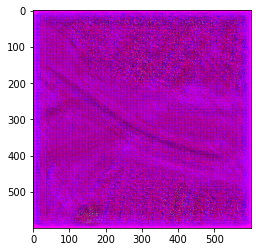

In [ ]:
with torch.no_grad():
  for i,j,k,l in test_load:
    i = i.cuda()
    j = j.cuda()
    k = k.cuda()
    l = l.cuda()
    i = gen(i)
    plt.imshow(np.transpose((i[0]*255).cpu().detach().numpy(), (1, 2, 0)))
    break

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

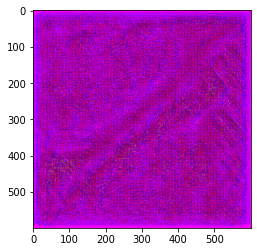

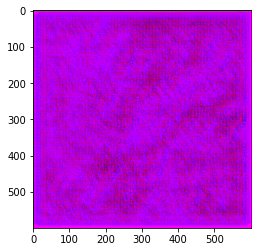

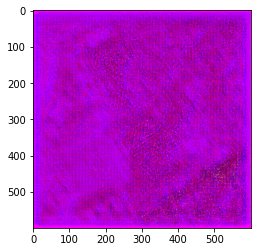

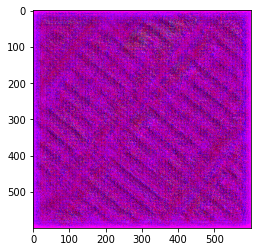

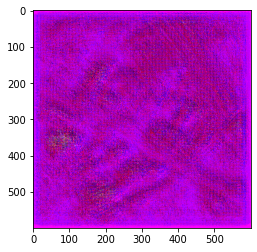

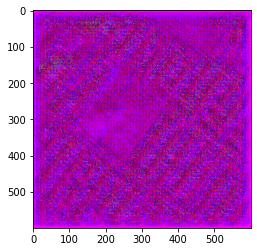

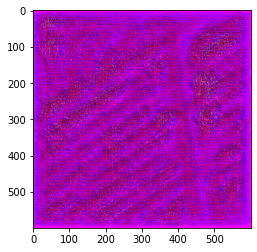

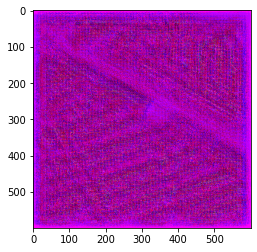

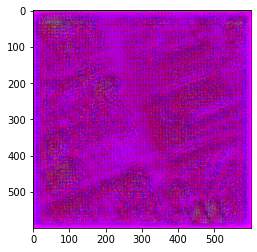

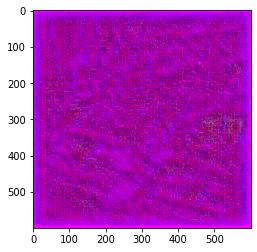

In [ ]:
with torch.no_grad():
  for i,_,_,_ in test_load:
    i = i.cuda()
    j = gen(i)
    for c in range(0,10):
      plt.figure()
      plt.imshow(np.transpose((j[c]*255).cpu().detach().numpy(), (1, 2, 0)))
    break

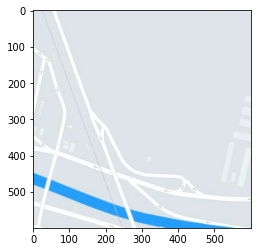

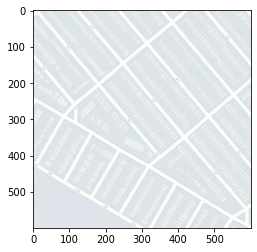

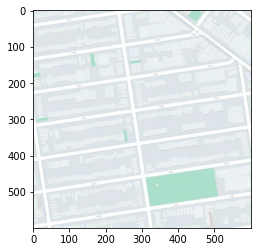

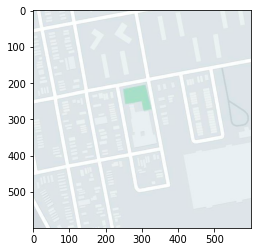

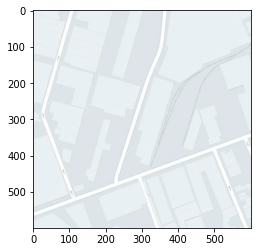

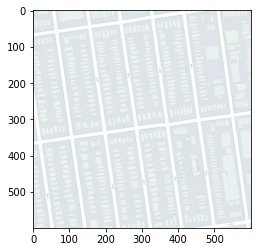

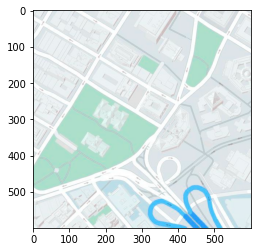

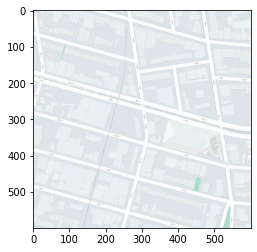

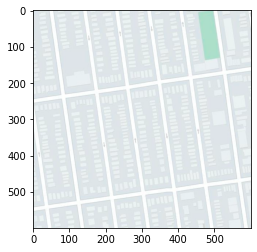

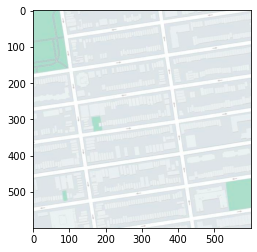

In [ ]:
with torch.no_grad():
  for _,_,k,_ in test_load:
    k = k.cuda()
    for c in range(0,10):
      plt.figure()
      plt.imshow(np.transpose((k[c]).cpu().detach().numpy(), (1, 2, 0)))
    break

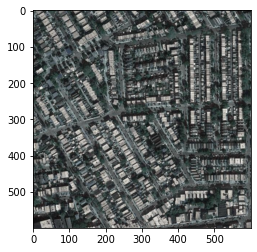

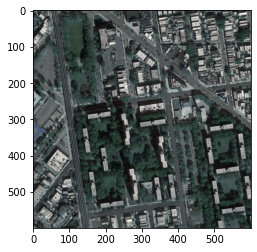

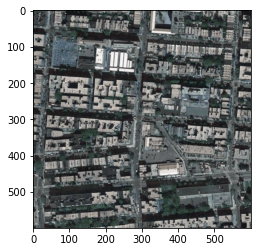

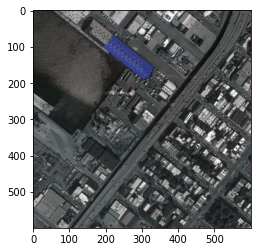

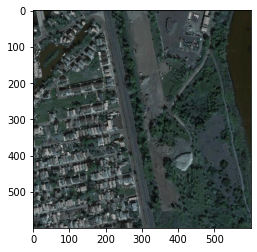

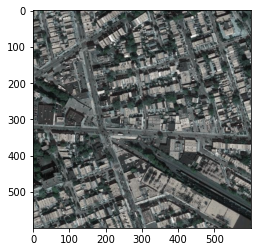

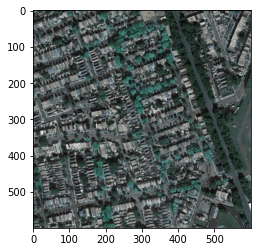

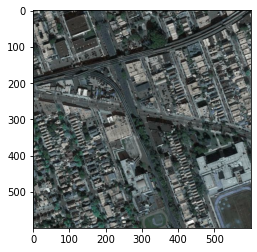

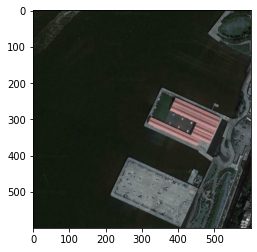

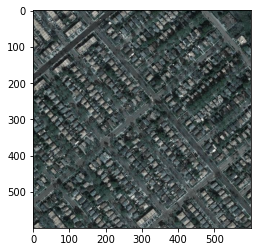

In [ ]:
with torch.no_grad():
  for i,_,_,_ in test_load:
    i = i.cuda()
    for c in range(0,10):
      plt.figure()
      plt.imshow(np.transpose((i[c]).cpu().detach().numpy(), (1, 2, 0)))
    break

In [ ]:
gen2 = Generator().cuda()
disc2 = Discriminator().cuda()

criterion = torch.nn.BCELoss().cuda()
optimizerD2 = torch.optim.Adam(disc2.parameters())
optimizerG2 = torch.optim.Adam(gen2.parameters())

G_losses_1 = []
D_losses_1 = []

for epoch in range(50):
  for inp_img, inp_lab, real_img, real_lab in tqdm(train_load):
    inp_img = inp_img.cuda()
    real_img = real_img.cuda()
    inp_lab = inp_lab.cuda()
    real_lab = real_lab.cuda()
    disc2.zero_grad()
    out_real = disc2(real_img).view(-1)
    error_real = criterion(out_real.type(torch.float32), real_lab.type(torch.float32))
    error_real.backward()
    D_x = out_real.mean().item()
    out_inp = disc2(gen2(inp_img)).view(-1)
    error_inp = criterion(out_inp.type(torch.float32), inp_lab.type(torch.float32))
    error_inp.backward()
    D_G_z1 = out_inp.mean().item()
    error = error_real + error_inp
    optimizerD2.step()
    gen2.zero_grad()
    output = disc2(inp_img).view(-1)
    errG = criterion(output.type(torch.float32), real_lab.type(torch.float32))
    errG.backward()
    D_G_z2 = output.mean().item()
    optimizerG2.step()
    G_losses_1.append(errG.item())
    D_losses_1.append(error.item())

100%|██████████| 18/18 [00:36<00:00,  2.05s/it]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

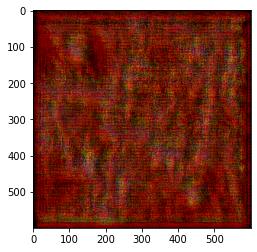

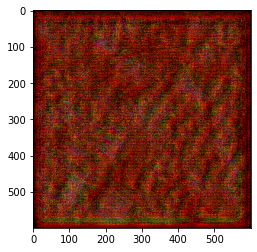

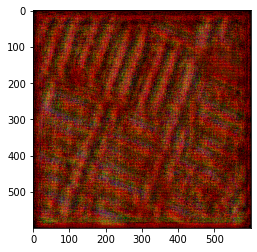

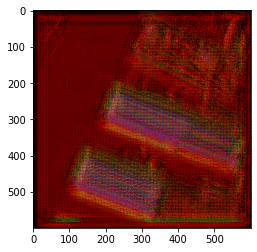

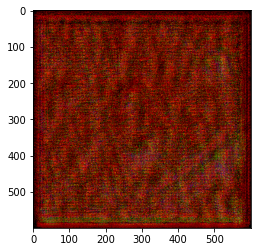

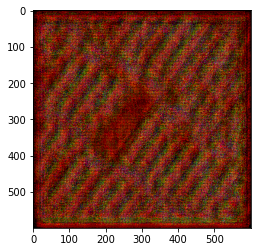

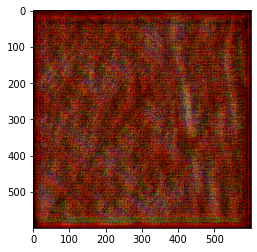

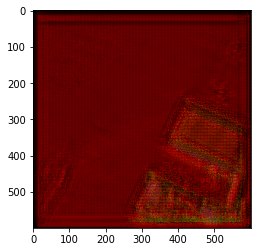

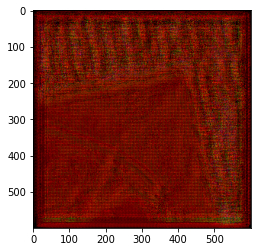

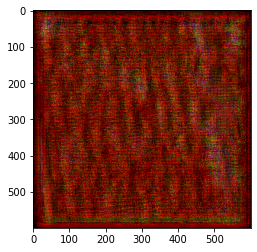

In [ ]:
with torch.no_grad():
  for i,_,_,_ in test_load:
    i = i.cuda()
    j = gen2(i)
    for c in range(0,10):
      plt.figure()
      plt.imshow(np.transpose((j[c]*255).cpu().detach().numpy(), (1, 2, 0)))
    break

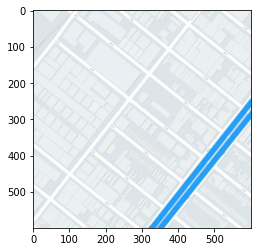

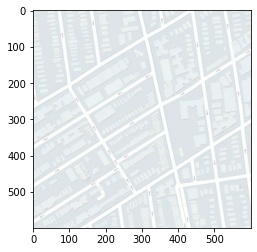

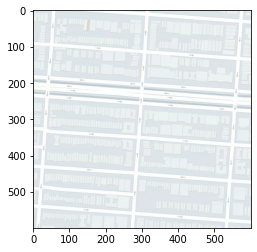

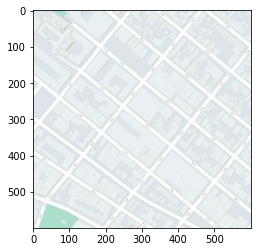

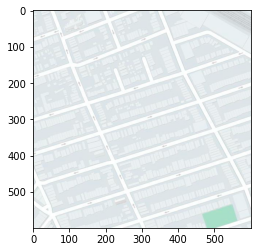

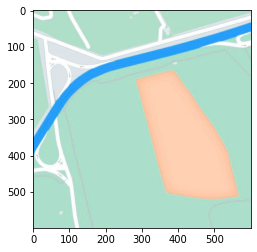

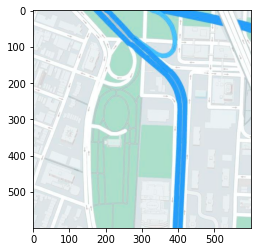

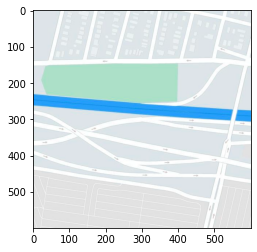

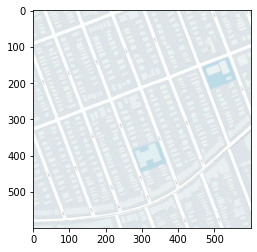

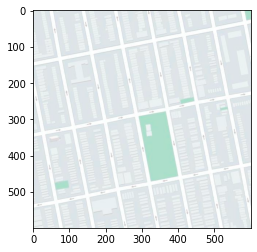

In [ ]:
with torch.no_grad():
  for _,_,k,_ in test_load:
    k = k.cuda()
    for c in range(0,10):
      plt.figure()
      plt.imshow(np.transpose((k[c]).cpu().detach().numpy(), (1, 2, 0)))
    break

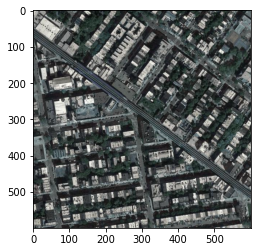

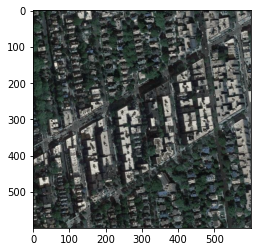

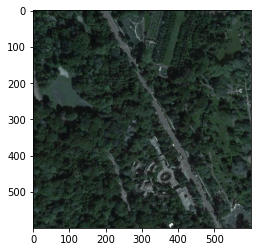

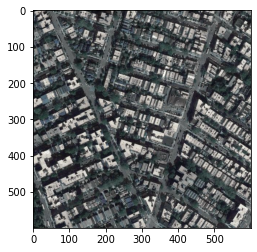

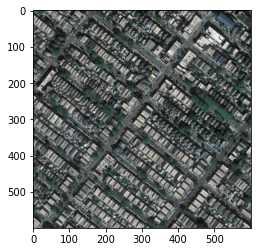

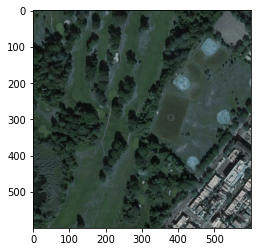

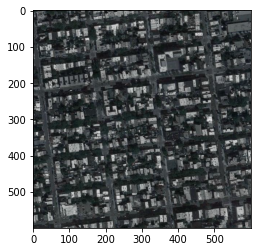

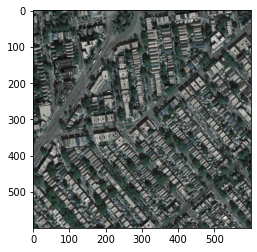

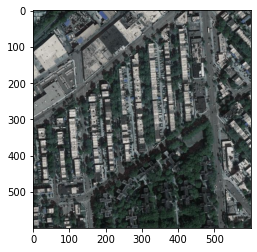

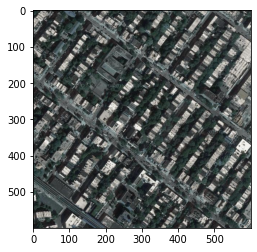

In [ ]:
with torch.no_grad():
  for i,_,_,_ in test_load:
    i = i.cuda()
    for c in range(0,10):
      plt.figure()
      plt.imshow(np.transpose((i[c]).cpu().detach().numpy(), (1, 2, 0)))
    break

In [ ]:
gen3 = Generator().cuda()
disc3 = Discriminator().cuda()

criterion = torch.nn.BCELoss().cuda()
optimizerD3 = torch.optim.Adam(disc3.parameters())
optimizerG3 = torch.optim.Adam(gen3.parameters())

G_losses_2 = []
D_losses_2 = []

for epoch in range(100):
  for inp_img, inp_lab, real_img, real_lab in tqdm(train_load):
    inp_img = inp_img.cuda()
    real_img = real_img.cuda()
    inp_lab = inp_lab.cuda()
    real_lab = real_lab.cuda()
    disc3.zero_grad()
    out_real = disc3(real_img).view(-1)
    error_real = criterion(out_real.type(torch.float32), real_lab.type(torch.float32))
    error_real.backward()
    D_x = out_real.mean().item()
    out_inp = disc3(gen3(inp_img)).view(-1)
    error_inp = criterion(out_inp.type(torch.float32), inp_lab.type(torch.float32))
    error_inp.backward()
    D_G_z1 = out_inp.mean().item()
    error = error_real + error_inp
    optimizerD3.step()
    gen3.zero_grad()
    output = disc3(inp_img).view(-1)
    errG = criterion(output.type(torch.float32), real_lab.type(torch.float32))
    errG.backward()
    D_G_z2 = output.mean().item()
    optimizerG3.step()
    G_losses_2.append(errG.item())
    D_losses_2.append(error.item())

100%|██████████| 18/18 [00:37<00:00,  2.06s/it]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

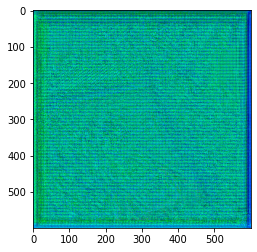

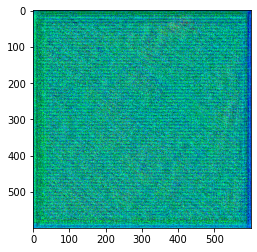

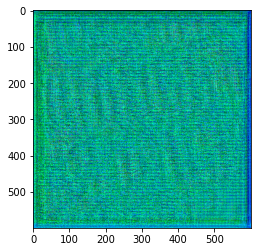

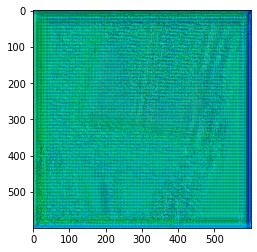

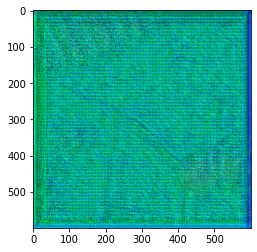

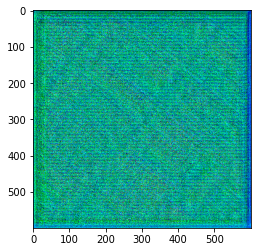

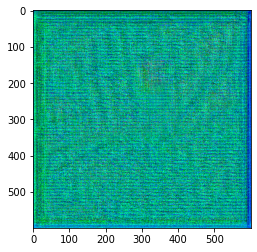

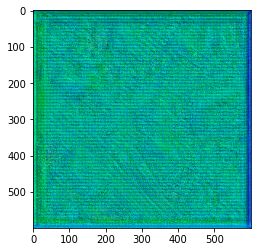

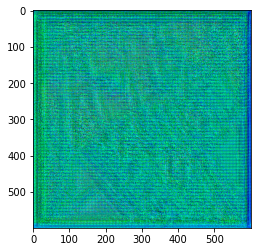

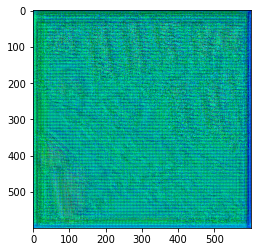

In [ ]:
with torch.no_grad():
  for i,_,_,_ in test_load:
    i = i.cuda()
    j = gen3(i)
    for c in range(0,10):
      plt.figure()
      plt.imshow(np.transpose((j[c]*255).cpu().detach().numpy(), (1, 2, 0)))
    break

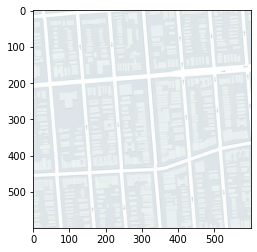

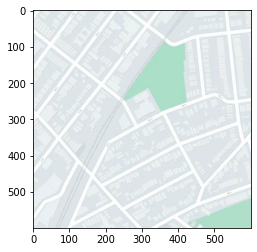

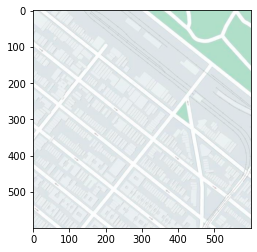

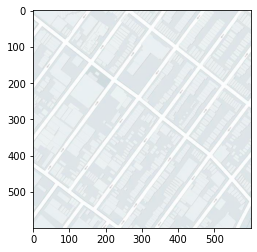

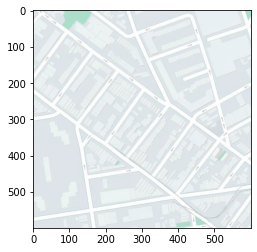

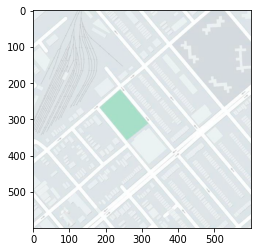

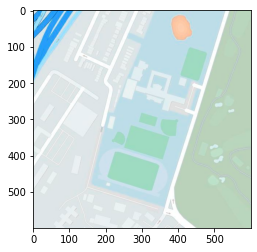

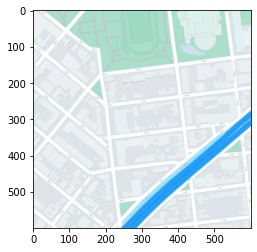

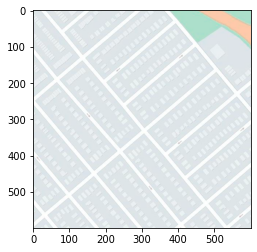

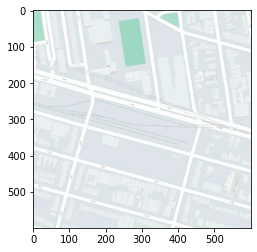

In [ ]:
with torch.no_grad():
  for _,_,k,_ in test_load:
    k = k.cuda()
    for c in range(0,10):
      plt.figure()
      plt.imshow(np.transpose((k[c]).cpu().detach().numpy(), (1, 2, 0)))
    break

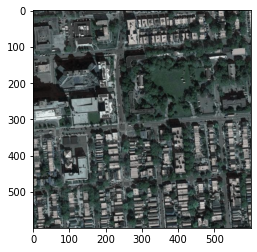

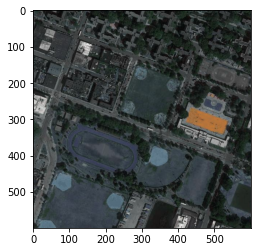

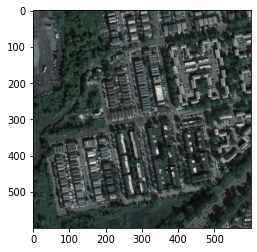

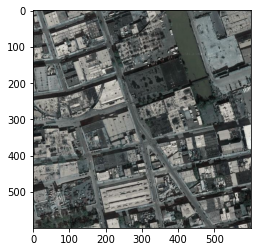

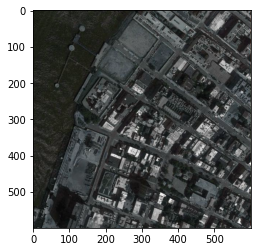

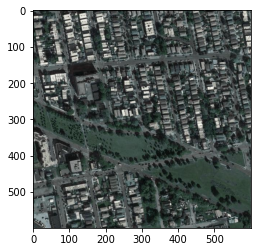

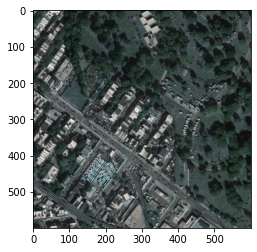

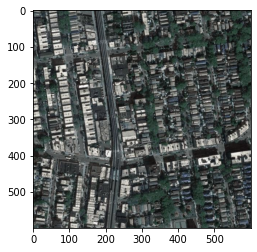

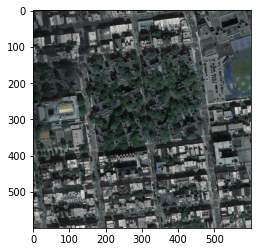

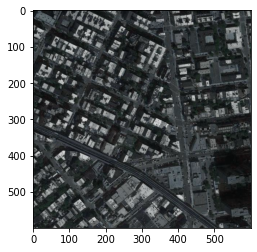

In [ ]:
with torch.no_grad():
  for i,_,_,_ in test_load:
    i = i.cuda()
    for c in range(0,10):
      plt.figure()
      plt.imshow(np.transpose((i[c]).cpu().detach().numpy(), (1, 2, 0)))
    break

In [ ]:
gen4 = Generator().cuda()
disc4 = Discriminator().cuda()

criterion = torch.nn.BCELoss().cuda()
optimizerD4 = torch.optim.Adam(disc4.parameters())
optimizerG4 = torch.optim.Adam(gen4.parameters())

G_losses_3 = []
D_losses_3 = []

for epoch in range(200):
  for inp_img, inp_lab, real_img, real_lab in tqdm(train_load):
    inp_img = inp_img.cuda()
    real_img = real_img.cuda()
    inp_lab = inp_lab.cuda()
    real_lab = real_lab.cuda()
    disc4.zero_grad()
    out_real = disc4(real_img).view(-1)
    error_real = criterion(out_real.type(torch.float32), real_lab.type(torch.float32))
    error_real.backward()
    D_x = out_real.mean().item()
    out_inp = disc4(gen4(inp_img)).view(-1)
    error_inp = criterion(out_inp.type(torch.float32), inp_lab.type(torch.float32))
    error_inp.backward()
    D_G_z1 = out_inp.mean().item()
    error = error_real + error_inp
    optimizerD4.step()
    gen4.zero_grad()
    output = disc4(inp_img).view(-1)
    errG = criterion(output.type(torch.float32), real_lab.type(torch.float32))
    errG.backward()
    D_G_z2 = output.mean().item()
    optimizerG4.step()
    G_losses_3.append(errG.item())
    D_losses_3.append(error.item())

100%|██████████| 18/18 [00:38<00:00,  2.12s/it]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

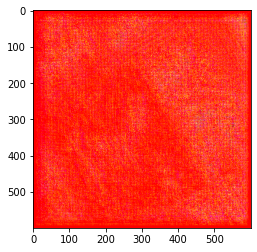

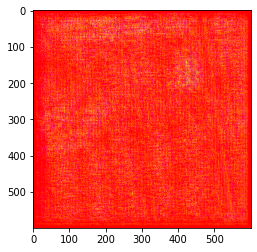

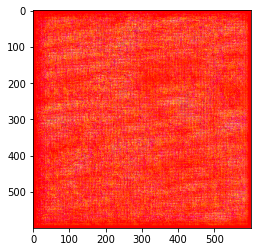

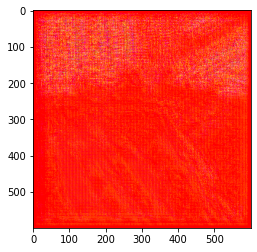

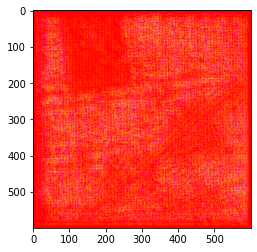

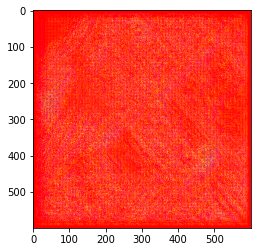

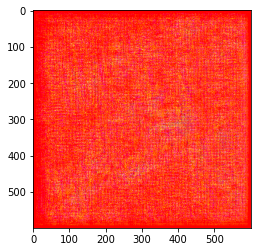

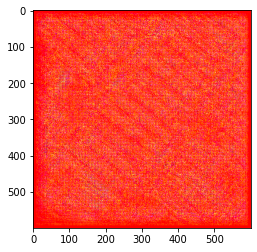

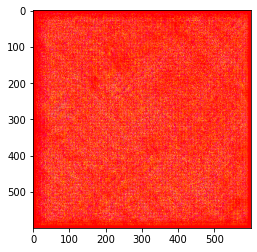

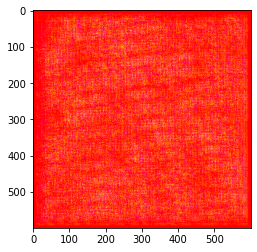

In [ ]:
with torch.no_grad():
  for i,_,_,_ in test_load:
    i = i.cuda()
    j = gen4(i)
    for c in range(0,10):
      plt.figure()
      plt.imshow(np.transpose((j[c]*255).cpu().detach().numpy(), (1, 2, 0)))
    break

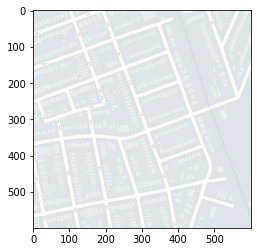

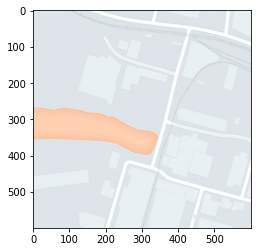

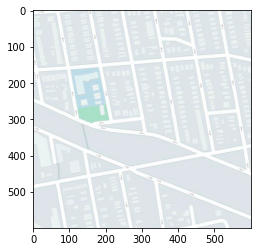

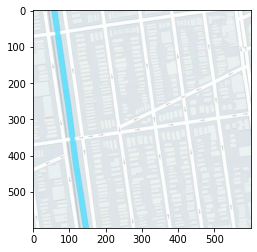

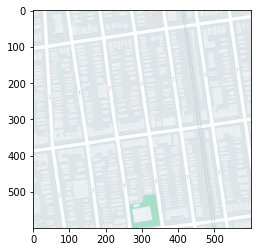

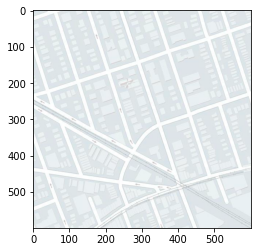

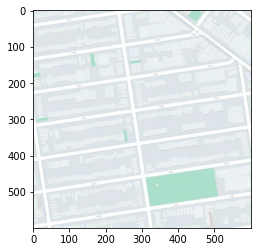

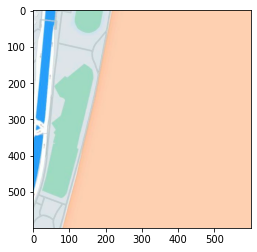

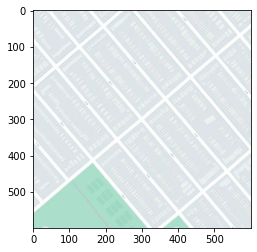

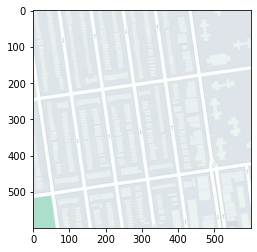

In [ ]:
with torch.no_grad():
  for _,_,k,_ in test_load:
    k = k.cuda()
    for c in range(0,10):
      plt.figure()
      plt.imshow(np.transpose((k[c]).cpu().detach().numpy(), (1, 2, 0)))
    break

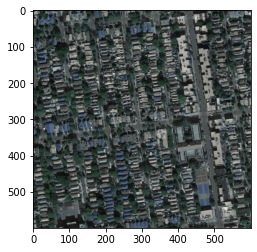

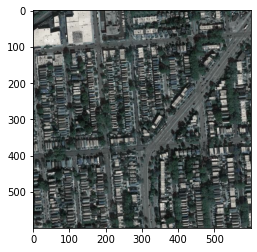

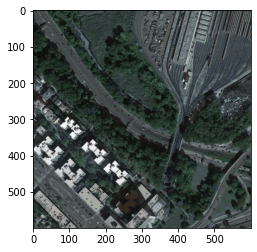

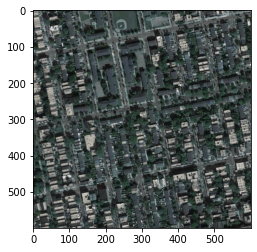

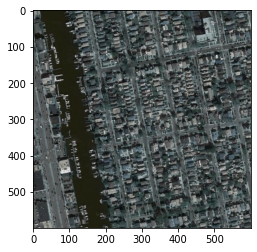

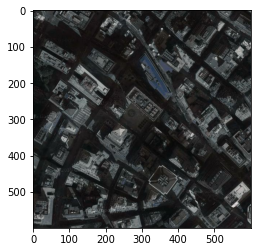

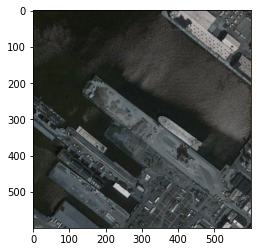

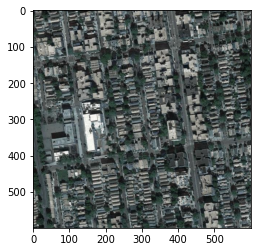

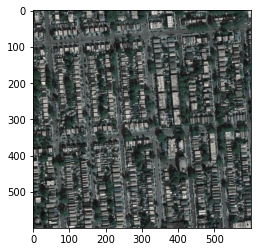

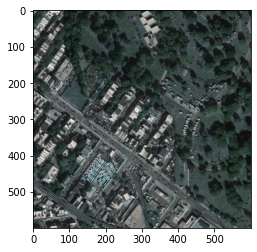

In [ ]:
with torch.no_grad():
  for i,_,_,_ in test_load:
    i = i.cuda()
    for c in range(0,10):
      plt.figure()
      plt.imshow(np.transpose((i[c]).cpu().detach().numpy(), (1, 2, 0)))
    break

In [ ]:
gen5 = Generator().cuda()
disc5 = Discriminator().cuda()

criterion = torch.nn.BCELoss().cuda()
optimizerD5 = torch.optim.Adam(disc5.parameters())
optimizerG5 = torch.optim.Adam(gen5.parameters())

G_losses_4 = []
D_losses_4 = []

for epoch in range(400):
  for inp_img, inp_lab, real_img, real_lab in tqdm(train_load):
    inp_img = inp_img.cuda()
    real_img = real_img.cuda()
    inp_lab = inp_lab.cuda()
    real_lab = real_lab.cuda()
    disc5.zero_grad()
    out_real = disc5(real_img).view(-1)
    error_real = criterion(out_real.type(torch.float32), real_lab.type(torch.float32))
    error_real.backward()
    D_x = out_real.mean().item()
    out_inp = disc5(gen5(inp_img)).view(-1)
    error_inp = criterion(out_inp.type(torch.float32), inp_lab.type(torch.float32))
    error_inp.backward()
    D_G_z1 = out_inp.mean().item()
    error = error_real + error_inp
    optimizerD5.step()
    gen5.zero_grad()
    output = disc5(inp_img).view(-1)
    errG = criterion(output.type(torch.float32), real_lab.type(torch.float32))
    errG.backward()
    D_G_z2 = output.mean().item()
    optimizerG5.step()
    G_losses_4.append(errG.item())
    D_losses_4.append(error.item())

100%|██████████| 18/18 [00:38<00:00,  2.13s/it]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

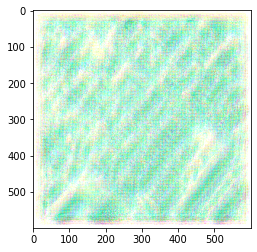

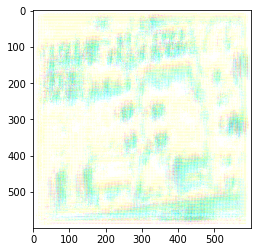

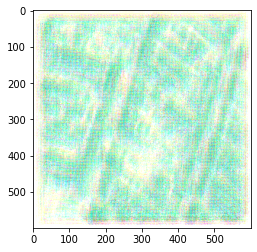

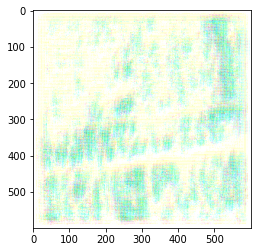

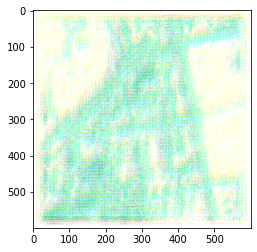

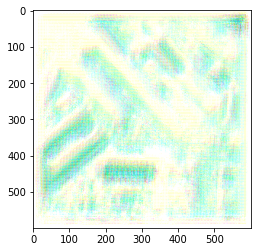

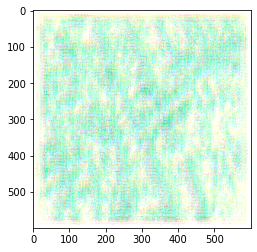

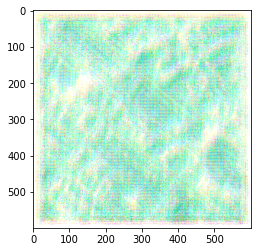

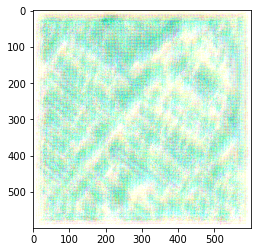

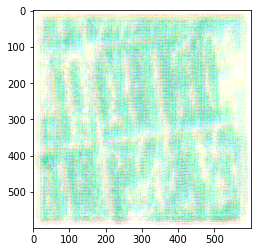

In [ ]:
with torch.no_grad():
  for i,_,_,_ in test_load:
    i = i.cuda()
    j = gen5(i)
    for c in range(0,10):
      plt.figure()
      plt.imshow(np.transpose((j[c]*255).cpu().detach().numpy(), (1, 2, 0)))
    break

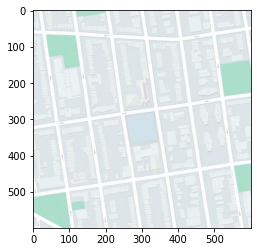

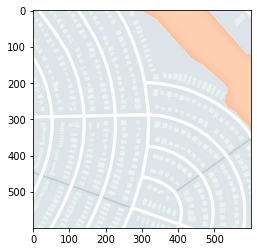

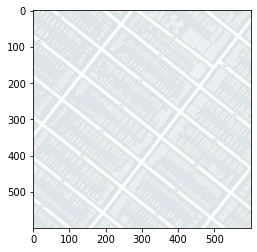

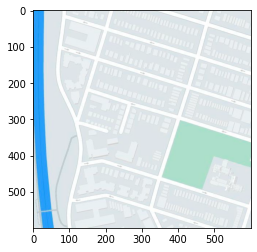

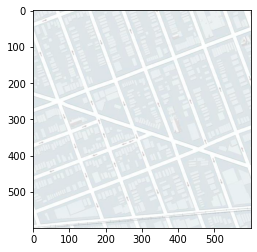

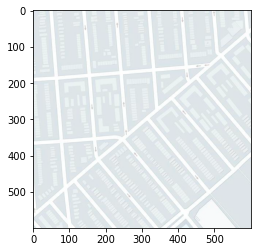

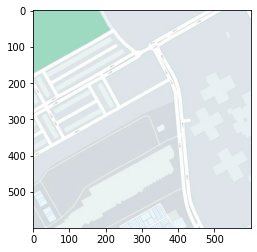

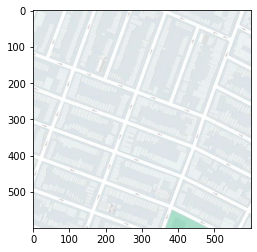

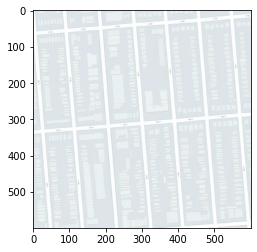

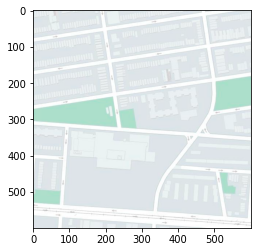

In [ ]:
with torch.no_grad():
  for _,_,k,_ in test_load:
    k = k.cuda()
    for c in range(0,10):
      plt.figure()
      plt.imshow(np.transpose((k[c]).cpu().detach().numpy(), (1, 2, 0)))
    break

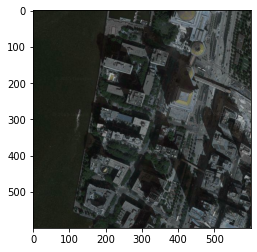

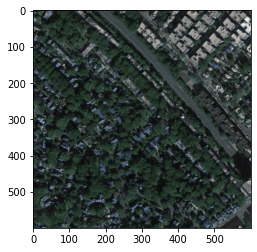

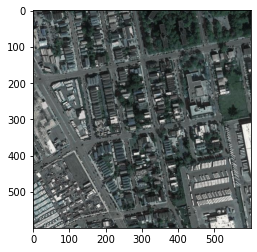

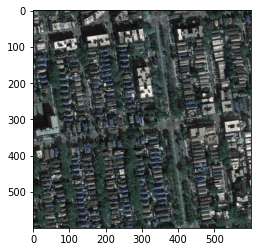

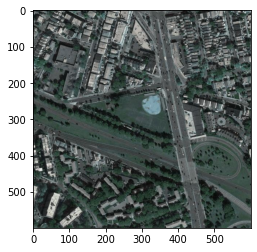

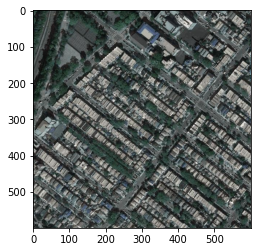

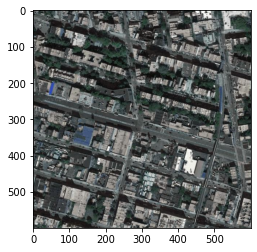

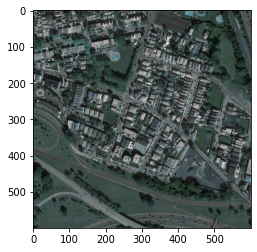

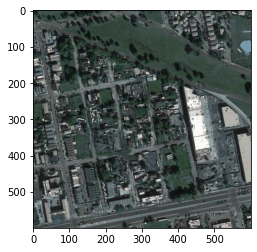

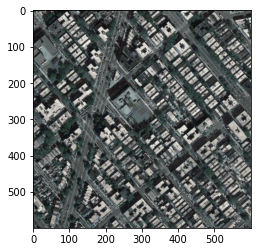

In [ ]:
with torch.no_grad():
  for i,_,_,_ in test_load:
    i = i.cuda()
    for c in range(0,10):
      plt.figure()
      plt.imshow(np.transpose((i[c]).cpu().detach().numpy(), (1, 2, 0)))
    break

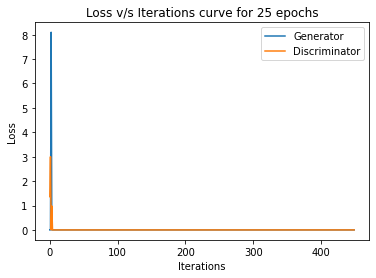

In [ ]:
plt.title("Loss v/s Iterations curve for 25 epochs")
plt.plot([n for n in range(0,len(G_losses))], G_losses)
plt.plot([n for n in range(0,len(D_losses))], D_losses)
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend(["Generator","Discriminator"])
plt.show()

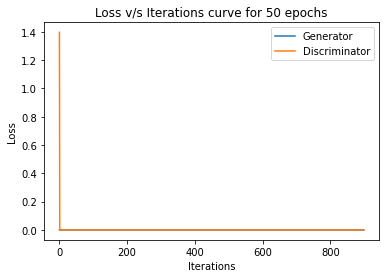

In [ ]:
plt.title("Loss v/s Iterations curve for 50 epochs")
plt.plot([n for n in range(0,len(G_losses_1))], G_losses_1)
plt.plot([n for n in range(0,len(D_losses_1))], D_losses_1)
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend(["Generator","Discriminator"])
plt.show()

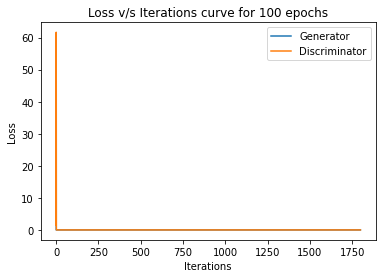

In [ ]:
plt.title("Loss v/s Iterations curve for 100 epochs")
plt.plot([n for n in range(0,len(G_losses_2))], G_losses_2)
plt.plot([n for n in range(0,len(D_losses_2))], D_losses_2)
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend(["Generator","Discriminator"])
plt.show()

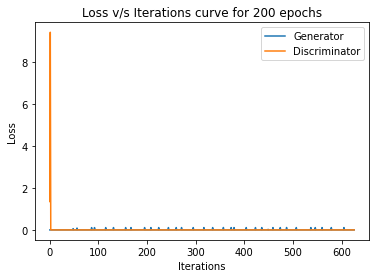

In [ ]:
plt.title("Loss v/s Iterations curve for 200 epochs")
plt.plot([n for n in range(0,len(G_losses_3))], G_losses_3)
plt.plot([n for n in range(0,len(D_losses_3))], D_losses_3)
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend(["Generator","Discriminator"])
plt.show()

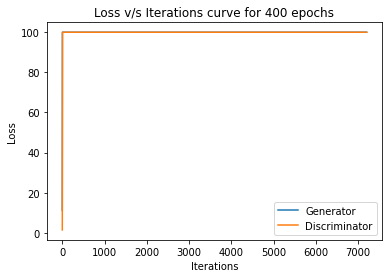

In [ ]:
plt.title("Loss v/s Iterations curve for 400 epochs")
plt.plot([n for n in range(0,len(G_losses_4))], G_losses_4)
plt.plot([n for n in range(0,len(D_losses_4))], D_losses_4)
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend(["Generator","Discriminator"])
plt.show()

In [ ]:
cd /content/drive/MyDrive/B19EE046_Q3

/content/drive/MyDrive/B19EE046_Q3


In [ ]:
!git clone https://github.com/junyanz/pytorch-CycleGAN-and-pix2pix

Cloning into 'pytorch-CycleGAN-and-pix2pix'...
remote: Enumerating objects: 2447, done.
remote: Total 2447 (delta 0), reused 0 (delta 0), pack-reused 2447
Receiving objects: 100% (2447/2447), 8.18 MiB | 14.29 MiB/s, done.
Resolving deltas: 100% (1535/1535), done.


In [ ]:
cd pytorch-CycleGAN-and-pix2pix

/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix


In [ ]:
!pip install -r requirements.txt

     |████████████████████████████████| 676 kB 23.1 MB/s 
     |████████████████████████████████| 1.8 MB 59.6 MB/s 
     |████████████████████████████████| 54 kB 2.3 MB/s 
     |████████████████████████████████| 181 kB 48.4 MB/s 
     |████████████████████████████████| 144 kB 84.5 MB/s 
     |████████████████████████████████| 63 kB 2.0 MB/s 
  Created wheel for visdom: filename=visdom-0.1.8.9-py3-none-any.whl size=655250 sha256=75329c08b02915ce0bc106270b4a754035938a80f2675ff83f906e04da65c0d1
  Stored in directory: /root/.cache/pip/wheels/2d/d1/9b/cde923274eac9cbb6ff0d8c7c72fe30a3da9095a38fd50bbf1
  Created wheel for pathtools: filename=pathtools-0.1.2-py3-none-any.whl size=8806 sha256=96bfcdd23763d1fbd01e2a7e123e0a060b0ff377d36e81fbeae04eea64050299
  Stored in directory: /root/.cache/pip/wheels/3e/31/09/fa59cef12cdcfecc627b3d24273699f390e71828921b2cbba2
  Created wheel for torchfile: filename=torchfile-0.1.0-py3-none-any.whl size=5709 sha256=69f280fb7d79c62186edf099b2a6895e20fefc85318e

In [ ]:
!bash /content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/scripts/download_cyclegan_model.sh sat2map

Note: available models are apple2orange, orange2apple, summer2winter_yosemite, winter2summer_yosemite, horse2zebra, zebra2horse, monet2photo, style_monet, style_cezanne, style_ukiyoe, style_vangogh, sat2map, map2sat, cityscapes_photo2label, cityscapes_label2photo, facades_photo2label, facades_label2photo, iphone2dslr_flower
Specified [sat2map]
for details.

--2022-05-03 17:13:10--  http://efrosgans.eecs.berkeley.edu/cyclegan/pretrained_models/sat2map.pth
Resolving efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)... 128.32.244.190
Connecting to efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)|128.32.244.190|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 45575747 (43M)
Saving to: ‘./checkpoints/sat2map_pretrained/latest_net_G.pth’

./checkpoints/sat2m 100%[===================>]  43.46M  14.4MB/s    in 3.3s    

2022-05-03 17:13:13 (13.1 MB/s) - ‘./checkpoints/sat2map_pretrained/latest_net_G.pth’ saved [45575747/45575747]



In [ ]:
!python test.py --dataroot '/content/drive/MyDrive/B19EE046_Q3/dataset/maps/val' --name sat2map_pretrained --model test --no_dropout

----------------- Options ---------------
             aspect_ratio: 1.0                           
               batch_size: 1                             
          checkpoints_dir: ./checkpoints                 
                crop_size: 256                           
                 dataroot: /content/drive/MyDrive/B19EE046_Q3/dataset/maps/val	[default: None]
             dataset_mode: single                        
                direction: AtoB                          
          display_winsize: 256                           
                    epoch: latest                        
                     eval: False                         
                  gpu_ids: 0                             
                init_gain: 0.02                          
                init_type: normal                        
                 input_nc: 3                             
                  isTrain: False                         	[default: None]
                load_iter: 0       

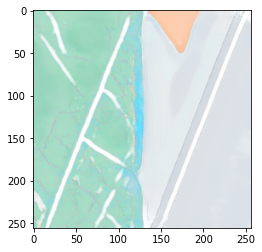

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1000_fake.png'))

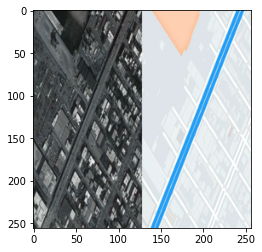

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1000_real.png'))

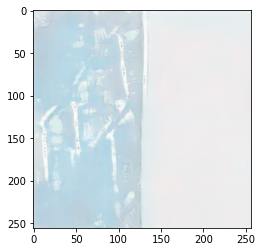

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1001_fake.png'))

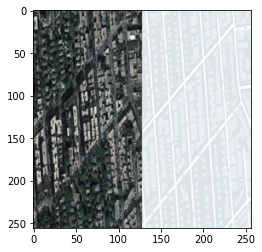

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1001_real.png'))

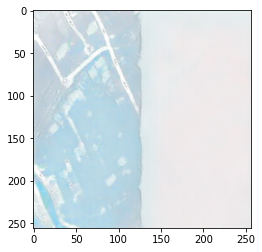

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1002_fake.png'))

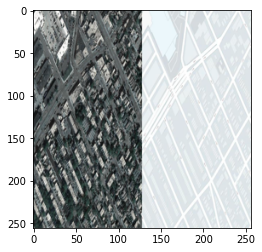

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1002_real.png'))

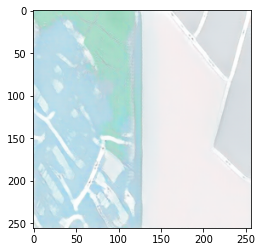

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1003_fake.png'))

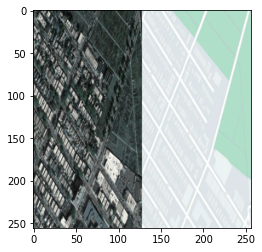

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1003_real.png'))

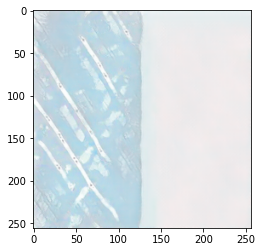

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1004_fake.png'))

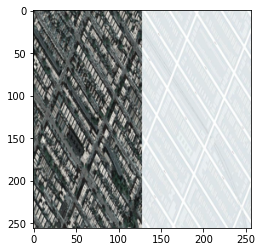

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1004_real.png'))

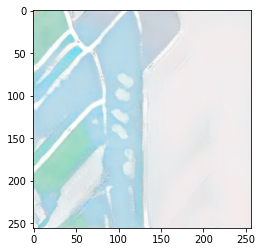

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1005_fake.png'))

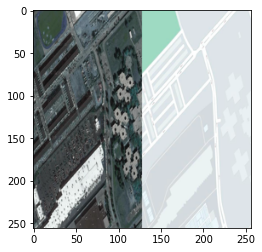

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1005_real.png'))

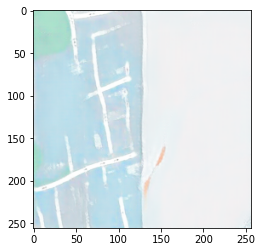

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1006_fake.png'))

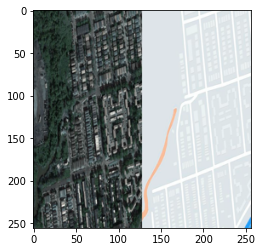

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1006_real.png'))

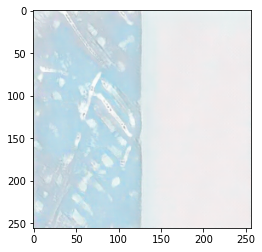

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1007_fake.png'))

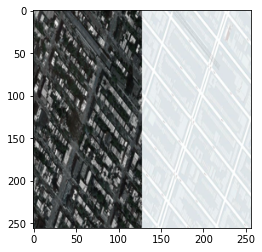

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1007_real.png'))

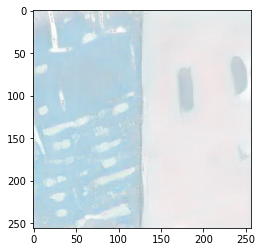

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1008_fake.png'))

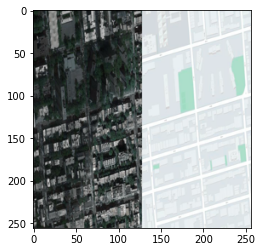

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1008_real.png'))

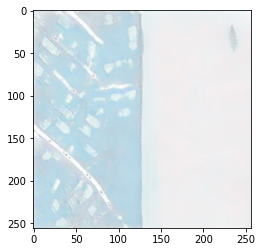

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1009_fake.png'))

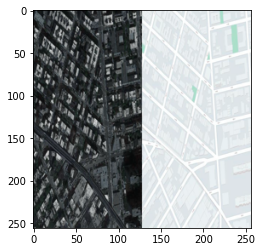

In [ ]:
plt.imshow(cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1009_real.png'))

In [ ]:
from skimage import metrics

imageA = cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1009_real.png')
imageB = cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1009_fake.png')

grayA = cv2.cvtColor(imageA, cv2.COLOR_BGR2GRAY)
grayB = cv2.cvtColor(imageB, cv2.COLOR_BGR2GRAY)

(score, diff) = metrics.structural_similarity(grayA, grayB, full=True)
print(score)

0.32701123960419504


In [ ]:
imageA = cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1008_real.png')
imageB = cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1008_fake.png')

grayA = cv2.cvtColor(imageA, cv2.COLOR_BGR2GRAY)
grayB = cv2.cvtColor(imageB, cv2.COLOR_BGR2GRAY)

(score, diff) = metrics.structural_similarity(grayA, grayB, full=True)
print(score)

0.367160145700354


In [ ]:
imageA = cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1007_real.png')
imageB = cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1007_fake.png')

grayA = cv2.cvtColor(imageA, cv2.COLOR_BGR2GRAY)
grayB = cv2.cvtColor(imageB, cv2.COLOR_BGR2GRAY)

(score, diff) = metrics.structural_similarity(grayA, grayB, full=True)
print(score)

0.33267614923327715


In [ ]:
imageA = cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1006_real.png')
imageB = cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1006_fake.png')

grayA = cv2.cvtColor(imageA, cv2.COLOR_BGR2GRAY)
grayB = cv2.cvtColor(imageB, cv2.COLOR_BGR2GRAY)

(score, diff) = metrics.structural_similarity(grayA, grayB, full=True)
print(score)

0.3719868008525211


In [ ]:
imageA = cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1005_real.png')
imageB = cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1005_fake.png')

grayA = cv2.cvtColor(imageA, cv2.COLOR_BGR2GRAY)
grayB = cv2.cvtColor(imageB, cv2.COLOR_BGR2GRAY)

(score, diff) = metrics.structural_similarity(grayA, grayB, full=True)
print(score)

0.44828985844483143


In [ ]:
imageA = cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1004_real.png')
imageB = cv2.imread('/content/drive/MyDrive/B19EE046_Q3/pytorch-CycleGAN-and-pix2pix/results/sat2map_pretrained/test_latest/images/1004_fake.png')

grayA = cv2.cvtColor(imageA, cv2.COLOR_BGR2GRAY)
grayB = cv2.cvtColor(imageB, cv2.COLOR_BGR2GRAY)

(score, diff) = metrics.structural_similarity(grayA, grayB, full=True)
print(score)

0.3337392001256452
